In [1]:
using Statistics
using Plots
using FFTW
using Statistics
using Optim
using Images, FileIO, ImageIO
using Printf
using Revise
using Profile
using LinearAlgebra
using JLD2
using Random
using Distributions
using FITSIO
using LineSearches
using Flux
using StatsBase
using SparseArrays

push!(LOAD_PATH, pwd()*"/../../../main")
using DHC_2DUtils
push!(LOAD_PATH, pwd()*"/../../../scratch_NM")
using Deriv_Utils_New
using Data_Utils
using Visualization
using ReconFuncs

**Summary**: 
1. Adding smoothedinit loss does indeed decrease the high J coeffs and gives me recon coeffs that look more like the true at high J.
2. Problem: The mean coeffs at low J are higher than the images' => I can't get the power spectrum to decrease beyond just the mean coeffs J at large K.
3. Case where Smoothed is safer than Noisy

In [ ]:
## Reg, RegCoeff
logbool = false
apdbool=true
isobool = false
Nx=64
filter_hash = fink_filter_hash(1, 8, nx=Nx, t=1, wd=1, Omega=true)
sfdall = readsfd_fromsrc("../../data/dust10000.fits", Nx, logbool=logbool)
dhc_args = Dict(:doS2=>false, :doS20=>true, :apodize=>apdbool, :iso=>isobool)
dbnocffs = get_dbn_coeffs(sfdall, filter_hash, dhc_args)
fmean = mean(dbnocffs, dims=1)
scov= (dbnocffs .- fmean)' * (dbnocffs .- fmean) ./(size(dbnocffs)[1] -1)
cond(scov)
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (dbnocffs .-  mean(dbnocffs, dims=1))')'
selidx = [3, 4]
selidx2 = [3, 7]

In [22]:
filter_hash["J_L"][[1, 2], :]

2×2 Array{Int32,2}:
 0  0
 1  0

In [23]:
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Real im, Not log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Real im, Not log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

In [10]:
eps = randn(1192, 10000)
covsq = cholesky(scov+Diagonal(ones(1192).*1e-5)).U
qsamps = fmean .+ (covsq*eps)'

10000×1192 Array{Float64,2}:
  -95.3436   -12.9565    -2.34218  …  0.0995218  1.02766  0.319031
  763.26      78.5299  -185.949       0.0934941  1.02204  0.317979
  157.29     256.502    -16.1851      0.103996   1.02388  0.319496
  306.067     84.1736   -57.7283      0.100551   1.0176   0.312398
  271.96     182.601   -121.533       0.102191   1.03123  0.312644
 -630.098   -273.248    174.954    …  0.0962514  1.02148  0.317652
  418.449    415.968   -151.267       0.0976616  1.03419  0.314338
 -691.393   -188.955    131.251       0.100516   1.02581  0.309741
 -250.859    -94.8474    33.0829      0.101189   1.02791  0.314498
  139.197    -59.3544   -64.594       0.0939942  1.02383  0.320157
  -43.4273  -162.857     47.3453   …  0.101705   1.02781  0.319041
 -207.0      -52.4378    93.9398      0.0980114  1.02162  0.318099
  367.767    419.508    -35.703       0.106332   1.01742  0.313631
    ⋮                              ⋱             ⋮        
  811.56     311.918   -235.431       0.0

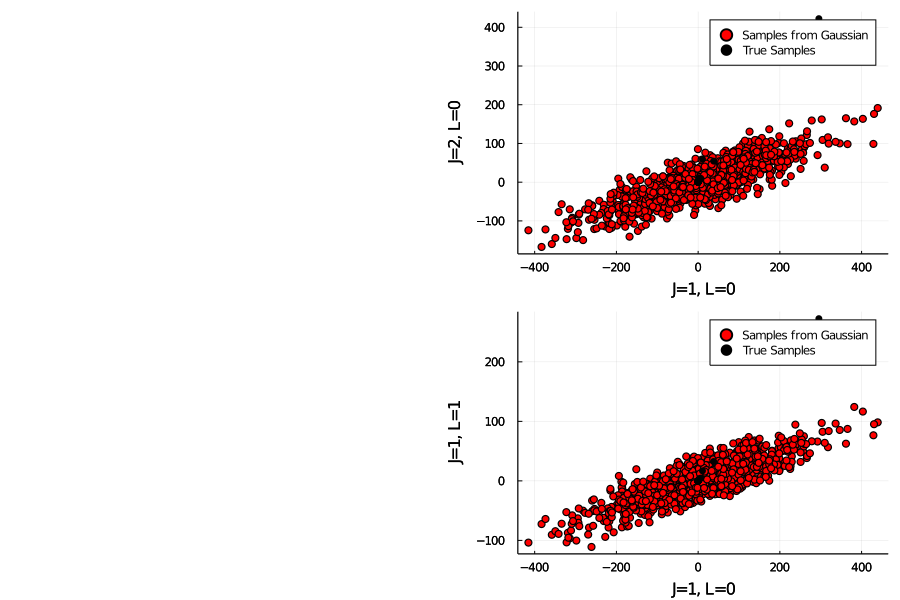

In [26]:
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(dbnocffs[1:1000, selidx[1]], dbnocffs[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(dbnocffs[1:1000, selidx2[1]], dbnocffs[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

## With LogCoeff

In [29]:
logdbn = log.(dbnocffs)
flmean = mean(logdbn, dims=1)
scov= (logdbn .- flmean)' * (logdbn .- flmean) ./(size(logdbn)[1] -1)
cond(scov)
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (logdbn .- flmean)')'

Cond No before inversion5.498913854538276e8
Numerical error wrt Id2.0316776664462219e-10


10000×1192 Adjoint{Float64,Array{Float64,2}}:
 -1.27966    -1.13239    -0.0377906   …  -0.775797    0.421644    -0.756356
 -0.0839349   0.510017   -0.075886       -0.213018    1.25864      1.31728
 -0.0842718   0.202403   -0.0503145       0.450854   -0.424647    -0.0487087
 -0.51814    -0.10391    -0.0196236       0.859141    0.230566    -0.726524
 -0.178642    1.14898    -0.00930096     -1.57446     0.455037     1.08304
  0.919124    0.163591    0.112102    …  -0.052681    0.877275     0.487653
 -0.0447889  -0.027166   -0.0459702       0.390845    0.882634    -0.304827
  0.3453      0.381597   -0.00367236      0.33363     0.456379     1.25845
  0.910945   -0.386346    0.114152       -0.438937    0.0666888    0.141049
 -0.442522    0.310093   -0.0115625      -0.786078    1.24303      0.322771
 -0.0733816  -0.0767042  -0.0272891   …   1.92897    -0.234831     0.261869
 -0.358884    1.99182    -0.0514788       0.0449522  -0.00149402  -0.336336
 -0.276805    0.957484   -0.07416        -1.

In [31]:
selidx = [3, 4]
selidx2 = [3, 7]
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Real im, Log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Real im, Log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

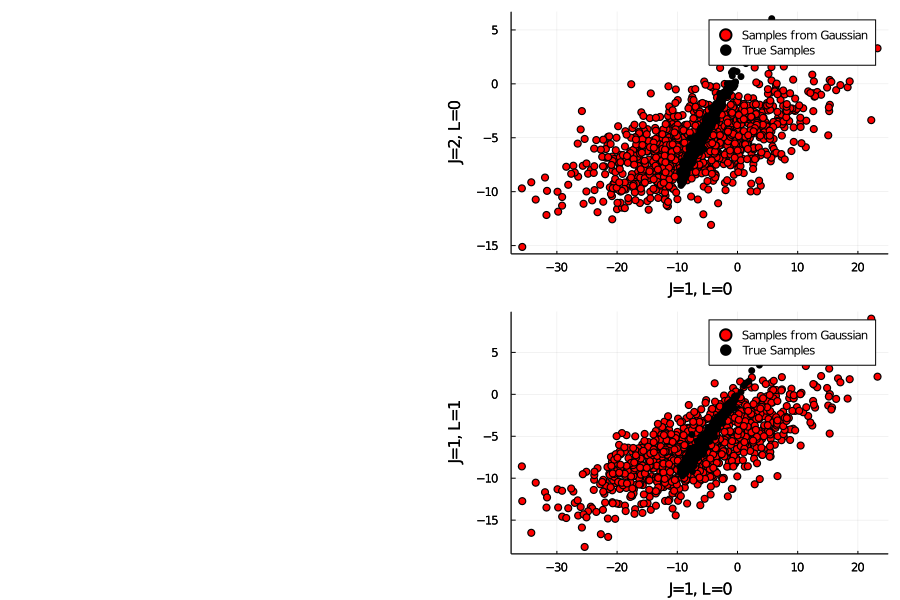

In [32]:
eps = randn(1192, 10000)
covsq = cholesky(scov+Diagonal(ones(1192).*1e-5)).U
qsamps = flmean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(logdbn[1:1000, selidx[1]], logdbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(logdbn[1:1000, selidx2[1]], logdbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

## Log Image

In [2]:
#Reg, RegCoeff
logbool = true
apdbool=true
isobool = false
Nx=64
filter_hash = fink_filter_hash(1, 8, nx=Nx, t=1, wd=1, Omega=true)
sfdall = readsfd_fromsrc("../../data/dust10000.fits", Nx, logbool=logbool)
dhc_args = Dict(:doS2=>false, :doS20=>true, :apodize=>apdbool, :iso=>isobool)
dbnocffs = get_dbn_coeffs(sfdall, filter_hash, dhc_args)
fmean = mean(dbnocffs, dims=1)
scov= (dbnocffs .- fmean)' * (dbnocffs .- fmean) ./(size(dbnocffs)[1] -1)
cond(scov)
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (dbnocffs .-  mean(dbnocffs, dims=1))')'
selidx = [3, 4]
selidx2 = [3, 7]

10000 slices
LOG
Cond No before inversion9.420619705478922e13
Numerical error wrt Id0.0012479920580997506


2-element Array{Int64,1}:
 3
 7

In [3]:
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Log im, Not log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Log im, Not log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

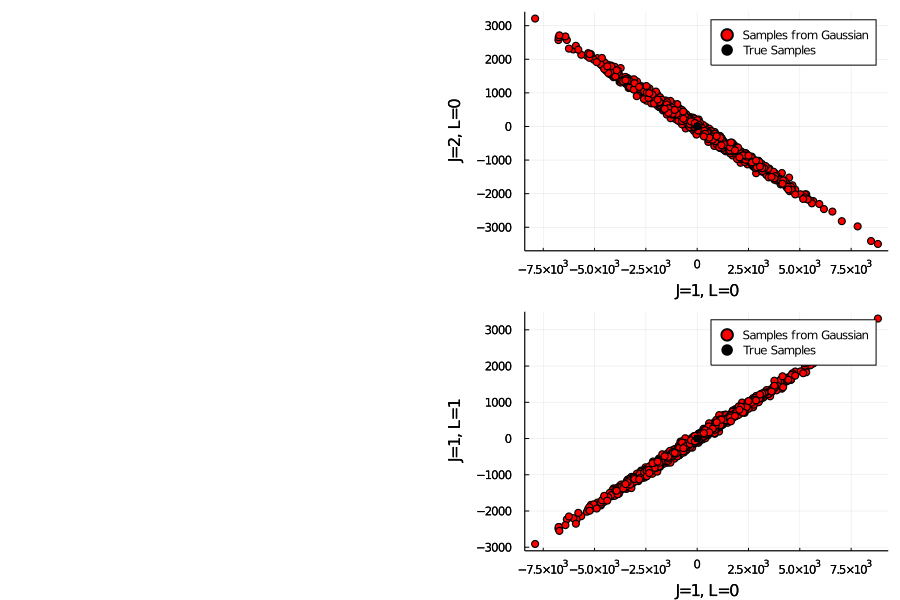

In [4]:
eps = randn(1192, 10000)
covsq = cholesky(scov+Diagonal(ones(1192).*1e-5)).U
qsamps = fmean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(dbnocffs[1:1000, selidx[1]], dbnocffs[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(dbnocffs[1:1000, selidx2[1]], dbnocffs[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

## LogCoeff

In [5]:
logdbn = log.(dbnocffs[:, 2:end])
flmean = mean(logdbn, dims=1)
scov= (logdbn .- flmean)' * (logdbn .- flmean) ./(size(logdbn)[1] -1)
cond(scov)
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (logdbn .- flmean)')'

Cond No before inversion3.584861308298839e7
Numerical error wrt Id1.3403930094758674e-11


10000×1191 Adjoint{Float64,Array{Float64,2}}:
 -0.827843   -0.0377322   -0.00193941  …  -0.898599    0.734342   -0.473179
 -0.552329   -0.0785816   -0.0663507       0.143498   -1.34056    -1.1765
 -0.261648   -0.0896821    0.0485039       0.557578    0.181034    0.0369884
 -0.383531   -0.0305521    0.0164121       0.848281    0.749122   -0.319705
  1.43684    -0.0339749   -0.030957       -1.39865    -0.93443    -0.16011
  0.581153    0.163981     0.0614913   …   0.231832   -0.190664   -0.729542
  0.0750465  -0.0541244   -0.0399086       0.320877    0.513395   -0.939573
  0.350771   -0.0548223   -0.0317201       0.71431    -1.04305    -0.188806
 -0.339363    0.0406918   -0.0410718      -0.147939    0.0763973  -0.331619
 -0.135956   -0.00173636   0.0938712      -0.571652   -0.0420392  -1.31836
 -0.0441793  -0.0892377   -0.071544    …   1.82673     0.193692    0.0114967
  0.725357   -0.00982267  -0.0123166       0.574502    0.430552    0.143385
  0.760409   -0.0300593   -0.0658269      -1

In [6]:
selidx = [2, 3]
selidx2 = [2, 6]
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Log im, Log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Log im, Log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

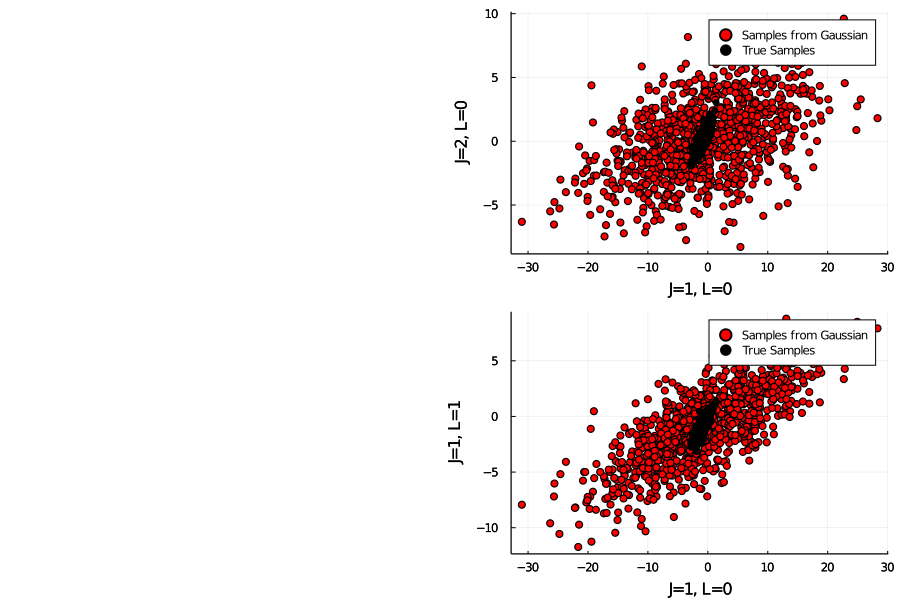

In [7]:
eps = randn(1191, 10000)
covsq = cholesky(Symmetric(scov+Diagonal(ones(1191).*1e-5))).U
qsamps = flmean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(logdbn[1:1000, selidx[1]], logdbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(logdbn[1:1000, selidx2[1]], logdbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

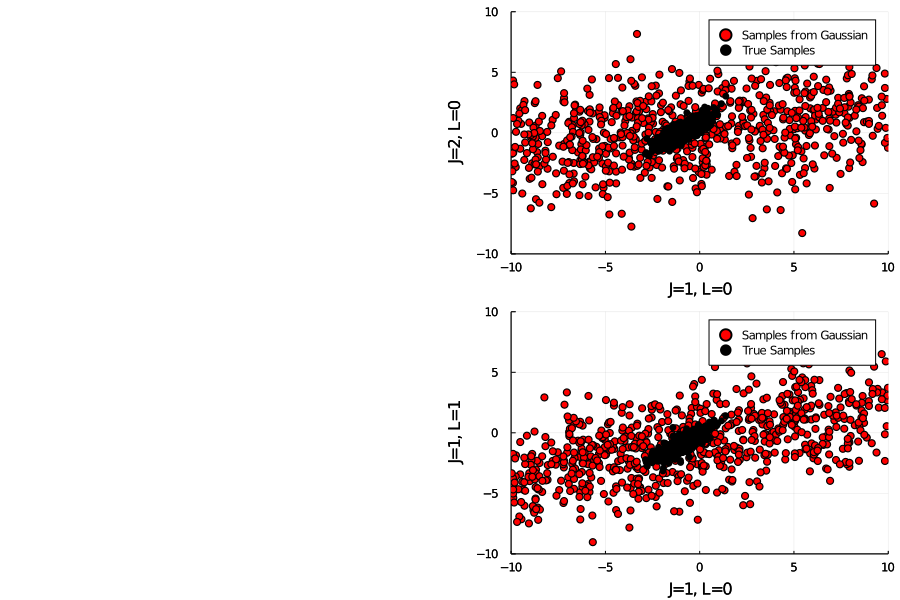

In [11]:
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-10, 10), ylim=(-10, 10)), 
    scatter!(logdbn[1:1000, selidx[1]], logdbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-10, 10), ylim=(-10, 10)),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-10, 10), ylim=(-10, 10)), 
    scatter!(logdbn[1:1000, selidx2[1]], logdbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-10, 10), ylim=(-10, 10)), size=(900, 600))

**Summary**:
* Log Coeff with both log and not log images is better in that the Gaussian looks more like the true sample distribution.
* Log Image *alone* is not better than Reg Image. Log Image+Log Coeff looks decent.

### Removing extreme images is better?

In [123]:
#Reg, RegCoeff
logbool = false
apdbool=true
isobool = false
Nx=64
filter_hash = fink_filter_hash(1, 8, nx=Nx, t=1, wd=1, Omega=true)
sfdall = readsfd_fromsrc("../../data/dust10000.fits", Nx, logbool=logbool)
dhc_args = Dict(:doS2=>false, :doS20=>true, :apodize=>apdbool, :iso=>isobool)
dbnocffs = get_dbn_coeffs(sfdall, filter_hash, dhc_args)
fmean = mean(dbnocffs, dims=1)
scov= (dbnocffs .- fmean)' * (dbnocffs .- fmean) ./(size(dbnocffs)[1] -1)
cond(scov)
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (dbnocffs .-  mean(dbnocffs, dims=1))')'
selidx = [3, 4]
selidx2 = [3, 7]

10000 slices
Cond No before inversion3.0623773937413853e10
Numerical error wrt Id8.489555617971846e-7


2-element Array{Int64,1}:
 3
 7

In [124]:
function distribution_percentiles(dbn, idx, perc)
    idxperc = zeros(size(idx))
    idxperc .= (x-> percentile(dbn[:, x], perc)).(idx)
    return idxperc
end

distribution_percentiles (generic function with 1 method)

In [125]:
pct99vals = reshape(distribution_percentiles(dbnocffs, collect(1:1192), 99), (1, 1192))
cmask = (dbnocffs .> pct99vals)
extrcontridx = (z->sum(cmask[z, :] .== 1)).(collect(1:10000))

10000-element Array{Int64,1}:
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 ⋮
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0
 0

In [126]:
extrcontridx[extrcontridx .> 0]

273-element Array{Int64,1}:
   10
  201
  201
  118
  303
 1192
  208
   22
    6
 1192
   11
 1187
  392
    ⋮
   10
    2
  396
  142
   12
   30
   30
  907
    2
  256
  503
    6

In [127]:
extridx = findall(!iszero, extrcontridx)
println(extridx)
println(extrcontridx[extrcontridx.>0])

[46, 76, 83, 97, 144, 200, 233, 240, 252, 264, 287, 313, 328, 397, 400, 430, 502, 522, 543, 557, 604, 666, 675, 721, 777, 842, 890, 902, 943, 957, 1036, 1043, 1075, 1196, 1225, 1278, 1304, 1331, 1334, 1375, 1387, 1407, 1570, 1576, 1590, 1594, 1634, 1675, 1677, 1717, 1752, 1773, 1784, 1785, 1788, 1823, 1837, 1873, 1892, 1907, 1989, 2068, 2165, 2183, 2254, 2291, 2303, 2350, 2461, 2469, 2498, 2499, 2518, 2614, 2799, 2815, 2864, 2971, 2987, 3043, 3114, 3139, 3222, 3223, 3280, 3303, 3329, 3330, 3359, 3407, 3421, 3473, 3517, 3593, 3797, 3812, 3946, 3959, 4068, 4084, 4091, 4093, 4147, 4182, 4200, 4247, 4297, 4298, 4312, 4321, 4329, 4341, 4342, 4343, 4386, 4394, 4404, 4432, 4493, 4521, 4546, 4584, 4598, 4667, 4801, 4802, 4813, 4817, 4828, 4839, 4850, 4858, 4910, 4927, 5025, 5060, 5084, 5114, 5123, 5156, 5220, 5224, 5285, 5292, 5294, 5350, 5410, 5438, 5440, 5514, 5551, 5555, 5592, 5636, 5647, 5657, 5696, 5715, 5719, 5759, 5793, 5832, 5839, 5850, 5914, 5932, 5945, 6050, 6093, 6119, 6133, 6243, 6

In [128]:
function J_hashindices(J_values, fhash)
    jindlist = []
    for jval in J_values
        push!(jindlist, findall(fhash["J_L"][:, 1].==jval))
    end
    return vcat(jindlist'...)
end

function J_S1indices(J_values, fhash)
    #Assumes this is applied to an object of length 2+Nf+Nf^2 or 2+Nf
    return J_hashindices(J_values, fhash) .+ 2
end

gets1s = J_S1indices([0, 1, 2, 3], filter_hash)

4×8 Array{Int64,2}:
 3   7  11  15  19  23  27  31
 4   8  12  16  20  24  28  32
 5   9  13  17  21  25  29  33
 6  10  14  18  22  26  30  34

In [129]:
sigall = std(dbnocffs, dims=1)

1×1192 Array{Float64,2}:
 0.121308  0.0718885  8.23288  12.7806  …  2.77989  1.37886  7.28353  8.43975

Phi1203.117 3.028
Omega0.177 -0.016


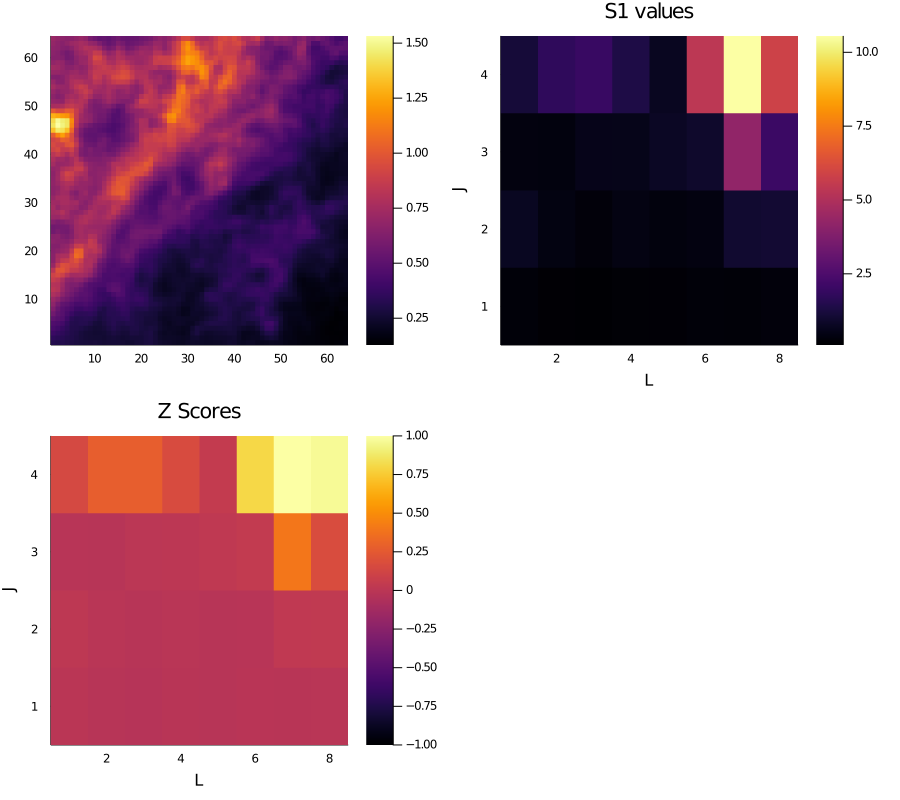

In [135]:
idx=46
allc = dbnocffs[idx, :]
s1c = allc[gets1s]
zc = (s1c .- fmean[gets1s])./sigall[gets1s]
println("Phi", round(allc[35], digits=3), " ",round((allc[35] .- fmean[35])./sigall[35], digits=3))
println("Omega", round(allc[36], digits=3), " ", round((allc[36] .- fmean[36])./sigall[36], digits=3))
p=plot(heatmap(sfdall[:, :, idx]), heatmap(s1c, xlabel="L", ylabel="J", title="S1 values"), heatmap(zc, xlabel="L", ylabel="J", title="Z Scores", clim=(-1, 1)), size=(900, 800))

In [136]:
normalidx = findall(iszero, extrcontridx)

9727-element Array{Int64,1}:
     1
     2
     3
     4
     5
     6
     7
     8
     9
    10
    11
    12
    13
     ⋮
  9989
  9990
  9991
  9992
  9993
  9994
  9995
  9996
  9997
  9998
  9999
 10000

In [137]:
#=10000 slices
Cond No raw cov = 4e42
Cond No before inversion3.0623773937413853e10
Numerical error wrt Id8.489555617971846e-7=#
subdbn = dbnocffs[normalidx, :]
submean = mean(subdbn, dims=1)
subcov= (subdbn .- submean)' * (subdbn .- submean) ./(size(subdbn)[1] -1)
println("Cond No raw cov", cond(subcov))
subcovinv = invert_covmat(subcov, 1e-5)

Cond No raw cov5.672243116223538e42
Cond No before inversion4.41122843797966e9
Numerical error wrt Id8.114288357160118e-11


1192×1192 Symmetric{Float64,Array{Float64,2}}:
 1255.93        -14.2673     -76.9142  …    -94.5753       0.726167
  -14.2673    99722.3         39.8718       -45.8783     -18.6651
  -76.9142       39.8718   84520.5          -85.1414    -571.41
  -18.959       -37.5874     459.998        -52.2038     834.108
   68.496       -66.7785      22.9562        99.4234      44.9881
  141.186        45.1482     100.515   …   -219.63       321.0
   79.1708      -57.1782    -928.684         59.692     -792.006
  -24.0853       18.9023     382.504         81.3455     185.813
  -61.6449      -36.4873    -104.077        119.616     -211.528
   40.0534      -82.932      188.483         38.1989    -172.437
   57.6179     -113.6        457.883   …    -14.4732     438.881
  -73.8672      -33.5051     -79.4478       105.875       65.4783
  -69.9299       35.7864    -172.314          2.77566     31.9667
    ⋮                                  ⋱      ⋮        
   65.1194      -54.9943     108.325   …   -760.

### Logcoeff

In [138]:
subdbn = log.(dbnocffs[normalidx, :])
submean = mean(subdbn, dims=1)
subcov= (subdbn .- submean)' * (subdbn .- submean) ./(size(subdbn)[1] -1)
println("Cond No raw cov", cond(subcov))
subcovinv = invert_covmat(subcov, 1e-5)

Cond No raw cov4.715560685506055e38
Cond No before inversion4.34412818287647e8
Numerical error wrt Id1.6899932566755815e-10


1192×1192 Symmetric{Float64,Array{Float64,2}}:
 27569.3      448.426       -62.0725    …   -529.18        -14.2259
   448.426     59.7282       -0.198598       -54.8721        1.4066
   -62.0725    -0.198598  50252.1             29.0265       21.8638
   -64.1985    -2.8898        8.84857         16.1358       10.2497
   -26.8734    -2.6776       -0.922374        13.675         3.35088
    -9.54345    2.47052      -1.38759   …      5.8684       -0.352793
   -36.1475    -3.12949       6.06102         18.5356       28.9665
   -64.2723    -0.424939     -2.83075         -0.832154      6.05763
    -1.52788    0.226268     -1.8557          -0.368517     -3.34473
  -117.297    -12.0735       -1.01883         19.9957       -4.87553
   -41.9867    -0.409027     -2.90404   …     10.5081       20.6897
   -51.1674    -1.21542      -1.84035          9.28198      -3.84535
   -20.0018    -0.328714     -0.208935        12.2207       -2.20187
     ⋮                                  ⋱      ⋮         
   

In [139]:
scovinv = invert_covmat(subcov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (subdbn .- submean)')'
selidx = [2, 3]
selidx2 = [2, 6]
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Log im, Log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Log im, Log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

Cond No before inversion4.34412818287647e8
Numerical error wrt Id1.6899932566755815e-10


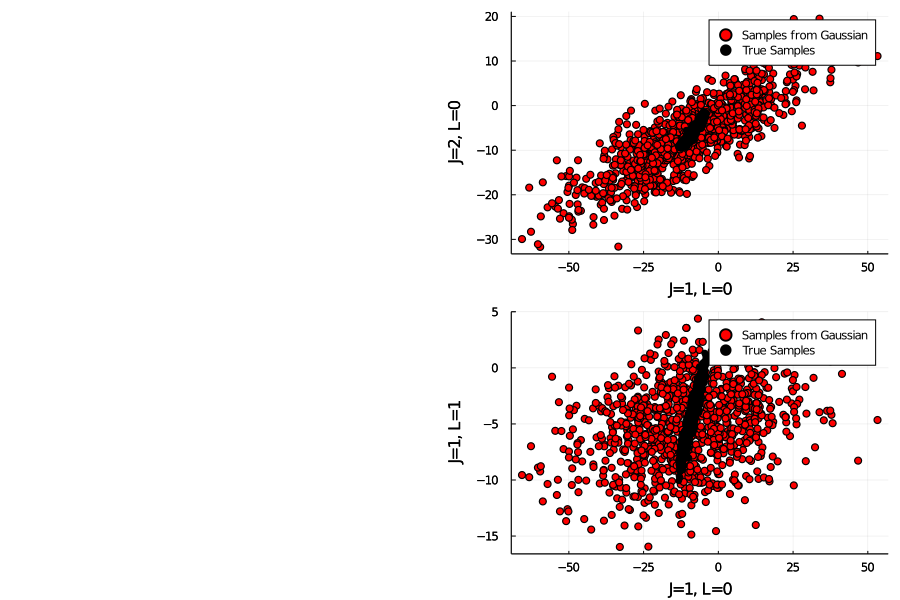

In [140]:
eps = randn(1192, 10000)
covsq = cholesky(Symmetric(subcov+Diagonal(ones(1192).*1e-5))).U
qsamps = submean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(subdbn[1:1000, selidx[1]], subdbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(subdbn[1:1000, selidx2[1]], subdbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

**Summary**:
* Condition number (for coeffs and logcoeff) does not decrease on removing images contributing to the extreme coefficients.
* Both point source and other images have high J coeffs mostly.
* Plot wise doesnt look any more Gaussian either.

**Is q(s1) also very different from the true distribution?** <br/>
**YES** Possibly even more different -- there seems to be an offset in the mean.

In [20]:
## Reg, RegCoeff
logbool = false
apdbool=true
isobool = false
Nx=64
filter_hash = fink_filter_hash(1, 8, nx=Nx, t=1, wd=1, Omega=true)
Nf = size(filter_hash["filt_index"])[1]
sfdall = readsfd_fromsrc("../../data/dust10000.fits", Nx, logbool=logbool)
dhc_args = Dict(:doS2=>false, :doS20=>true, :apodize=>apdbool, :iso=>isobool)
dbnocffs = get_dbn_coeffs(sfdall, filter_hash, dhc_args)
S1dbn = dbnocffs[:, 1:Nf+2]
fmean = mean(S1dbn, dims=1)
scov= (S1dbn .- fmean)' * (S1dbn .- fmean) ./(size(dbnocffs)[1] -1)
println("Raw Cov cond number", cond(scov))
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (S1dbn .-  fmean)')'
selidx = [3, 4]
selidx2 = [3, 7]
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Reg im, Reg coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Reg im, Reg coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

10000 slices
Raw Cov cond number3.70731778610584e19
Cond No before inversion1.3287469736672283e10
Numerical error wrt Id5.901083801990811e-10


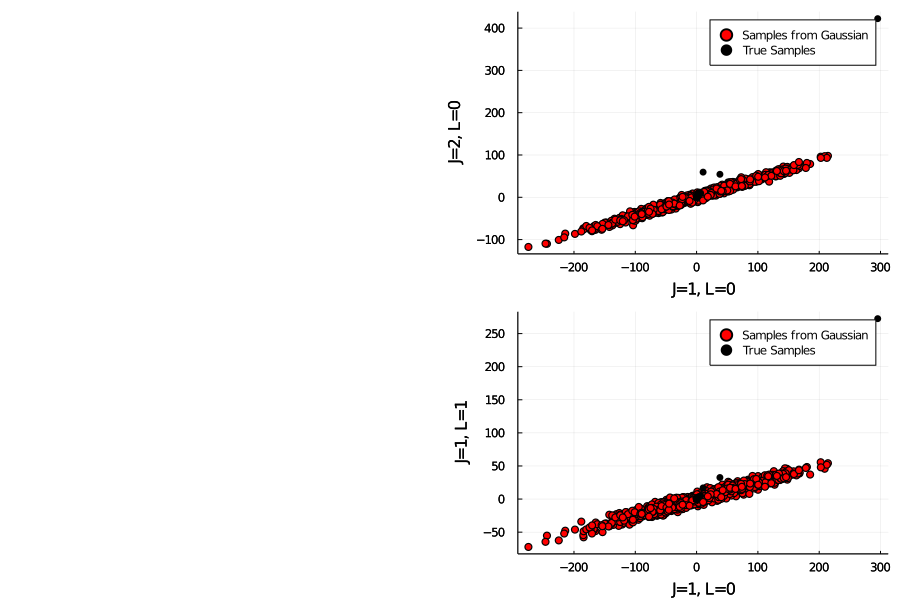

In [21]:
eps = randn(36, 10000)
covsq = cholesky(Symmetric(scov+Diagonal(ones(36).*1e-10))).U
qsamps = fmean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(S1dbn[1:1000, selidx[1]], S1dbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(S1dbn[1:1000, selidx2[1]], S1dbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

In [22]:
mean(qsamps[1:1000, selidx], dims=1)

1×2 Array{Float64,2}:
 1.01119  1.25461

In [23]:
mean(S1dbn[1:1000, selidx], dims=1)

1×2 Array{Float64,2}:
 0.377508  0.619856

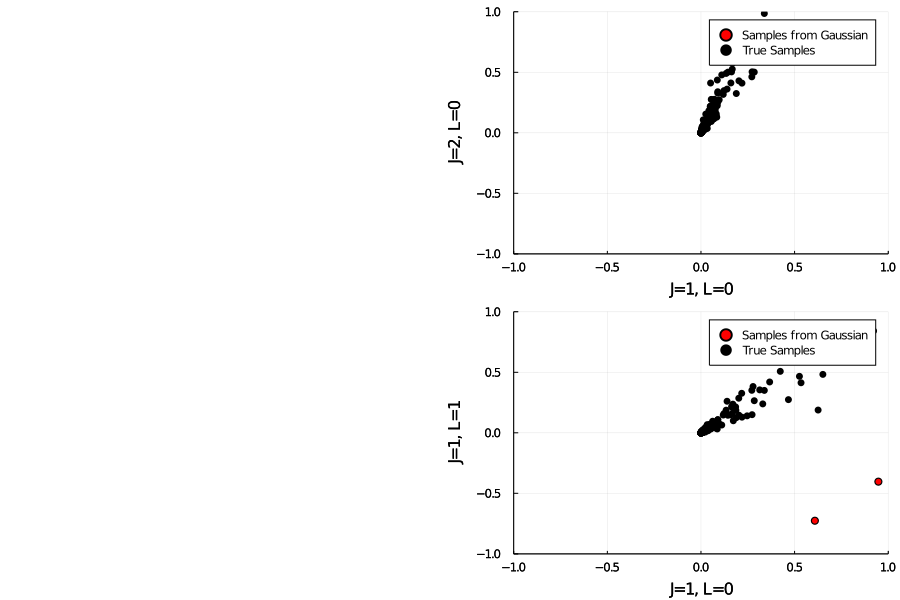

In [14]:
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-1, 1), ylim=(-1, 1)), 
    scatter!(S1dbn[1:1000, selidx[1]], S1dbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-1, 1), ylim=(-1, 1)),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-1, 1), ylim=(-1, 1)), 
    scatter!(S1dbn[1:1000, selidx2[1]], S1dbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-1, 1), ylim=(-1, 1)), size=(900, 600))

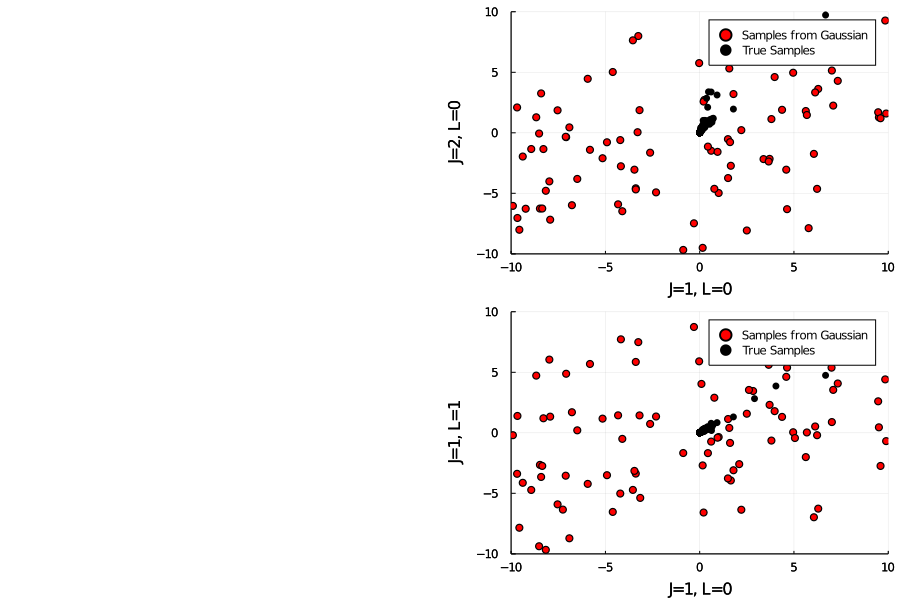

In [15]:
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-10, 10), ylim=(-10, 10)), 
    scatter!(S1dbn[1:1000, selidx[1]], S1dbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0", xlim=(-10, 10), ylim=(-10, 10)),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-10, 10), ylim=(-10, 10)), 
    scatter!(S1dbn[1:1000, selidx2[1]], S1dbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1", xlim=(-10, 10), ylim=(-10, 10)), size=(900, 600))

In [16]:
logS1dbn = log.(S1dbn)
flmean = mean(logS1dbn, dims=1)
scov = (logS1dbn .- flmean)' * (logS1dbn .- flmean) ./ (size(logS1dbn)[1] - 1)
println("Raw Cov cond number", cond(scov))
scovinv = invert_covmat(scov, 1e-5)
cholupp = cholesky(scovinv).U
whitened_ms = (cholupp * (logS1dbn .-  flmean)')'
selidx = [3, 4]
selidx2 = [3, 7]
p = plot(scatter(whitened_ms[:, selidx[1]], whitened_ms[:, selidx[2]], title="Reg im, Log coeffs", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
scatter(whitened_ms[:, selidx2[1]], whitened_ms[:, selidx2[2]], title="Reg im, Log coeffs", xlabel="J=1, L=0", ylabel="J=1, L=1"), size=(900, 600))

Raw Cov cond number4.283499259150068e6
Cond No before inversion3.3961750577744367e6
Numerical error wrt Id6.340144186915543e-13


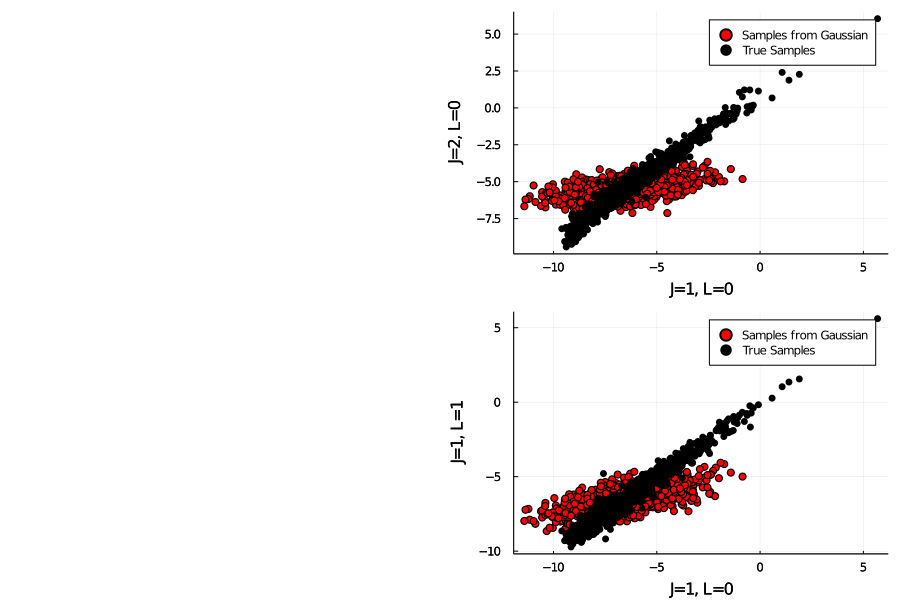

In [17]:
eps = randn(36, 10000)
covsq = cholesky(Symmetric(scov+Diagonal(ones(36).*1e-10))).U
qsamps = flmean .+ (covsq*eps)'
p = plot(scatter(qsamps[1:1000, selidx[1]], qsamps[1:1000, selidx[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=2, L=0"), 
    scatter!(logS1dbn[1:1000, selidx[1]], logS1dbn[1:1000, selidx[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=2, L=0"),
    scatter(qsamps[1:1000, selidx2[1]], qsamps[1:1000, selidx2[2]], label="Samples from Gaussian", color="red", xlabel="J=1, L=0", ylabel = "J=1, L=1"), 
    scatter!(logS1dbn[1:1000, selidx2[1]], logS1dbn[1:1000, selidx2[2]], label="True Samples", color="black", xlabel="J=1, L=0", ylabel = "J=1, L=1"), size=(900, 600))

In [26]:
sfdall = nothing